# View results with the provided script

First, as a sanity check, let's make sure we can load trained model and see what it looks like.

In [ ]:
%%bash
ADT_PROCESSED_ROOT=/home/jackd/source/egolifter/adt_processed
SCENE_NAME=Apartment_release_work_skeleton_seq131
OUTPUT_ROOT=/home/jackd/source/egolifter/output/adt

# Select one of the output folder from below
FOLDER_NAME=unc_2d_unet_egolifter
# FOLDER_NAME=unc_2d_unet_egolifter_static
# FOLDER_NAME=deform_egolifter_deform
echo "Running with folder name: ${OUTPUT_ROOT}/${SCENE_NAME}/${FOLDER_NAME}"

# This will start a local server 
# open the browser and go to the link for visualization
uv run python viewer.py \
    ${OUTPUT_ROOT}/${SCENE_NAME}/${FOLDER_NAME} \
    --data_root ${ADT_PROCESSED_ROOT}  \
    --reorient disable \
    --feat_pca

# Explore the scene data structure

What can we did into? Let's see what the data structure looks like. 

In [12]:
from utils.routines import load_from_model_path

ADT_PROCESSED_ROOT='/home/jackd/source/egolifter/adt_processed'
OUTPUT_ROOT='/home/jackd/source/egolifter/output/adt'

# Select a scene from below
# SCENE_NAME='Apartment_release_golden_skeleton_seq100_10s_sample'
SCENE_NAME='Apartment_release_work_skeleton_seq131'

# Select one of the output folder from below
# FOLDER_NAME='unc_2d_unet_egolifter'
FOLDER_NAME='vanilla_3dgs'

model_path = f'{OUTPUT_ROOT}/{SCENE_NAME}/{FOLDER_NAME}'
source_path= f'{ADT_PROCESSED_ROOT}/{SCENE_NAME}'

model, scene, cfg = load_from_model_path(
    model_path,
    source_path
)

Overriding source_path to /home/jackd/source/egolifter/adt_processed/Apartment_release_work_skeleton_seq131
Failed to initialize scene from /home/jackd/source/egolifter/adt_processed/Apartment_release_work_skeleton_seq131
Source path /home/jackd/source/egolifter/adt_processed/Apartment_release_work_skeleton_seq131 does not exist!
Try proceeding with scene set to None
Loading checkpoint from /home/jackd/source/egolifter/output/adt/Apartment_release_work_skeleton_seq131/vanilla_3dgs/chkpntstep=30000.ckpt


/home/jackd/source/egolifter/utils/system_utils.py:55: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt = torch.load(ckpt_path, map_location="cpu")


## Explore what attributes are in the model

In [ ]:
# Display the torch model architecture
print(model)

VanillaGaussian(
  (gaussians): GsplatModel()
)


In [ ]:
# Display the model parameters
for name, param in model.named_parameters():
    print(name, param.shape)

gaussians._xyz torch.Size([432081, 3])
gaussians._features_dc torch.Size([432081, 1, 3])
gaussians._features_rest torch.Size([432081, 15, 3])
gaussians._features_extra torch.Size([432081, 0])
gaussians._scaling torch.Size([432081, 3])
gaussians._rotation torch.Size([432081, 4])
gaussians._opacity torch.Size([432081, 1])


### List the attriubtes in GaussianModel

In [15]:
# List available attributes and methods
print(dir(model.gaussians))

# Nicely print the attributes names
print("Attributes of model.gaussians:")
for attr in dir(model.gaussians):
    if not attr.startswith('__'):
        print(attr)


['T_destination', '__annotations__', '__call__', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattr__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__setstate__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_apply', '_backward_hooks', '_backward_pre_hooks', '_buffers', '_call_impl', '_compiled_call_impl', '_features_dc', '_features_extra', '_features_rest', '_forward_hooks', '_forward_hooks_always_called', '_forward_hooks_with_kwargs', '_forward_pre_hooks', '_forward_pre_hooks_with_kwargs', '_get_backward_hooks', '_get_backward_pre_hooks', '_get_name', '_is_full_backward_hook', '_load_from_state_dict', '_load_state_dict_post_hooks', '_load_state_dict_pre_hooks', '_maybe_warn_non_full_backward_hook', '_modules', '_named_members', '_non_persistent_buffers_se

### Visualize 3D coordinates

In [16]:
model.gaussians.get_xyz.shape

torch.Size([432081, 3])

In [17]:
# Explore the properties of the GaussianModel instance.
print("GaussianModel properties:")
print(f"Centers: {model.gaussians.get_xyz}")

GaussianModel properties:
Centers: Parameter containing:
tensor([[ 2.3320,  0.9006,  3.9929],
        [ 2.4254,  0.8248,  4.0638],
        [ 2.2730,  0.9336,  4.0396],
        ...,
        [-3.7484,  0.0791,  4.7029],
        [-0.6699,  6.4217,  3.6909],
        [-0.4464,  6.2759,  0.2567]], device='cuda:0', requires_grad=True)


In [18]:
print("Shape of centers:", model.gaussians.get_xyz.shape)

Shape of centers: torch.Size([432081, 3])


In [19]:
# Compute statistics of the GaussianModel: model.gaussians.get_xyz
import numpy as np

# Convert the tensor to a NumPy array (if it's on CPU). We must detach from tf
xyz_array = model.gaussians.get_xyz.detach().cpu().numpy()  
mean = np.mean(xyz_array, axis=0)
print(f"Mean: {mean}")

Mean: [-1.5045087  2.0178616  1.145803 ]


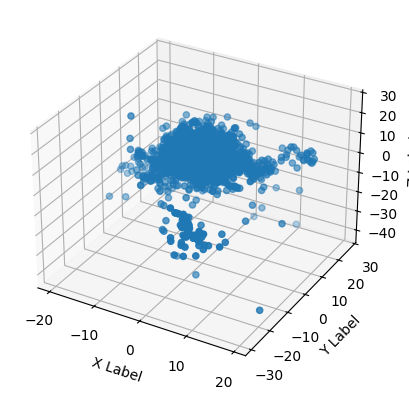

In [20]:
# Plot the 3d points
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(xyz_array[:, 0], xyz_array[:, 1], xyz_array[:, 2])
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

plt.show()

In [22]:
from scipy.stats import zscore
import plotly.graph_objects as go

# Compute Z-scores for the xyz_array
z_scores = zscore(xyz_array, axis=0)

# Define a threshold for outliers (e.g., 3 standard deviations)
threshold = 3

# Filter out rows where any Z-score exceeds the threshold
filtered_xyz_array = xyz_array[(abs(z_scores) < threshold).all(axis=1)]

# Create a 3D scatter plot with the filtered data
fig = go.Figure(data=[go.Scatter3d(
    x=filtered_xyz_array[:, 0],
    y=filtered_xyz_array[:, 1],
    z=filtered_xyz_array[:, 2],
    mode='markers',
    marker=dict(
        size=1,
        color='blue',  # Set color to blue
        opacity=0.1  # Set opacity to 0.1
    )
)])
# Set the layout with y-axis as the "up" direction
fig.update_layout(
    scene=dict(
        xaxis_title='X Axis',
        yaxis_title='Y Axis',
        zaxis_title='Z Axis',
        camera=dict(
            up=dict(x=0, y=1, z=0)  # Set x-axis as the "up" direction
        )
    ),
    title='3D Scatter Plot of Gaussian Centers'
)
# Show the plot
fig.show()

# Explore lifted features

## The Basics

In [23]:
feats = model.gaussians.get_features_extra
print("Features shape:", feats.shape)

Features shape: torch.Size([432081, 0])


In [24]:
# Print data statistics summary using pandas
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Load the data
data = model.gaussians.get_features_extra.detach().cpu().numpy()
# Convert to DataFrame
df = pd.DataFrame(data, columns=[f'Feature_{i}' for i in range(data.shape[1])])
# Print the first few rows
print(df.head())
# Print the summary statistics
print(df.describe())
# Plot the distribution of each feature in a grid
num_features = len(df.columns)
num_cols = 4  # Number of columns in the grid
num_rows = (num_features + num_cols - 1) // num_cols  # Calculate required rows

fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 4 * num_rows))
axes = axes.flatten()

for i, column in enumerate(df.columns):
    sns.histplot(df[column], bins=30, kde=True, ax=axes[i])
    axes[i].set_title(f'Distribution of {column}')
    axes[i].set_xlabel(column)
    axes[i].set_ylabel('Frequency')

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

Empty DataFrame
Columns: []
Index: [0, 1, 2, 3, 4]


ValueError: Cannot describe a DataFrame without columns

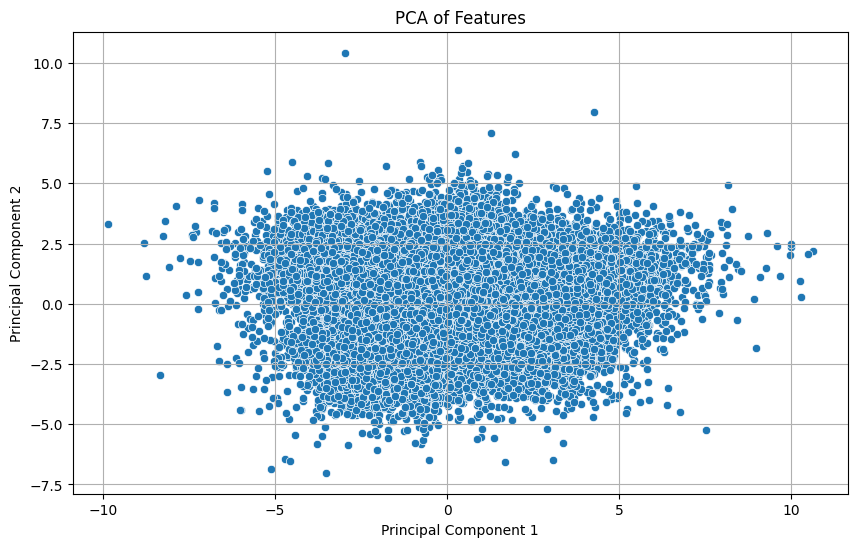

In [ ]:
# Perform PCA
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Load the data
data = model.gaussians.get_features_extra.detach().cpu().numpy()
# Standardize the data
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)
# Perform PCA
pca = PCA(n_components=2)
data_pca = pca.fit_transform(data_scaled)
# Create a DataFrame for the PCA results
df_pca = pd.DataFrame(data_pca, columns=['PC1', 'PC2'])
# Plot the PCA results
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', data=df_pca)
plt.title('PCA of Features')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid()
plt.show()

## Explore features in LDA

In [98]:
# Load the data
data = model.gaussians.get_features_extra.detach().cpu().numpy()
data_std = StandardScaler().fit_transform(data)

In [99]:
from sklearn.neighbors import NearestNeighbors
knn = NearestNeighbors(n_neighbors=15, metric="cosine").fit(data_std)
knn_graph = knn.kneighbors_graph(mode="distance")     # sparse matrix

/home/ubuntu/egolifter/.venv/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.



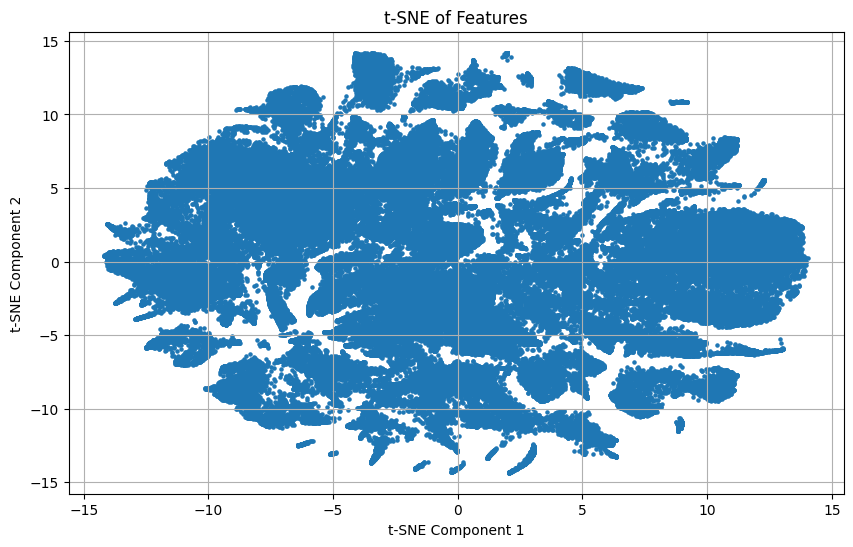

In [102]:
# Calculate tsne
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, perplexity=30, n_iter=300, random_state=42)
X_tsne = tsne.fit_transform(data_std)
# Plot the t-SNE results
plt.figure(figsize=(10, 6))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], s=5)
plt.title('t-SNE of Features')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.grid()
plt.show()

In [103]:
import umap

umap2d = umap.UMAP(
    n_neighbors=15,        # matches knn above
    min_dist=0.1,          # 0 → tighter clusters, >0.4 → looser
    metric="cosine"
).fit_transform(X_std)     # shape (N, 2)

/home/ubuntu/egolifter/.venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



In [104]:
import hdbscan
labels = hdbscan.HDBSCAN(min_cluster_size=20, metric="euclidean").fit_predict(umap2d)

/home/ubuntu/egolifter/.venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

/home/ubuntu/egolifter/.venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



In [107]:
import plotly.express as px
fig = px.scatter(x=umap2d[:,0], y=umap2d[:,1],
                 color=labels.astype(str),
                 #hover_data=dict(index=list(range(len(data)))),
                 )
fig.show()